In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor


import warnings
warnings.filterwarnings('ignore')

pd.pandas.set_option('display.max_columns',None)

#import for plotting graphs
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
    

## Read CSV and Display Dataset


In [2]:
dataset = pd.read_csv("/Users/rutujaghate/Downloads/housing.csv")
print(dataset)

                id                                                url  \
0       7049044568  https://reno.craigslist.org/apa/d/reno-beautif...   
1       7049047186  https://reno.craigslist.org/apa/d/reno-reduced...   
2       7043634882  https://reno.craigslist.org/apa/d/sparks-state...   
3       7049045324  https://reno.craigslist.org/apa/d/reno-1x1-fir...   
4       7049043759  https://reno.craigslist.org/apa/d/reno-no-long...   
...            ...                                                ...   
384972  7049053337  https://reno.craigslist.org/apa/d/reno-2x2-thi...   
384973  7049052968  https://reno.craigslist.org/apa/d/sparks-over-...   
384974  7049050454  https://reno.craigslist.org/apa/d/sparks-1mont...   
384975  7049050149  https://reno.craigslist.org/apa/d/sparks-ready...   
384976  7049050010  https://reno.craigslist.org/apa/d/reno-2x2-thi...   

              region                   region_url  price       type  sqfeet  \
0       reno / tahoe  https://reno.craigslis

## Display top 5 records

In [3]:
dataset.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7049044568,https://reno.craigslist.org/apa/d/reno-beautif...,reno / tahoe,https://reno.craigslist.org,1148,apartment,1078,3,2.0,1,1,0,0,0,0,w/d in unit,carport,https://images.craigslist.org/01616_daghmBUvTC...,Ridgeview by Vintage is where you will find al...,39.5483,-119.796,ca
1,7049047186,https://reno.craigslist.org/apa/d/reno-reduced...,reno / tahoe,https://reno.craigslist.org,1200,condo,1001,2,2.0,0,0,0,0,0,0,w/d hookups,carport,https://images.craigslist.org/00V0V_5va0MkgO9q...,Conveniently located in the middle town of Ren...,39.5026,-119.789,ca
2,7043634882,https://reno.craigslist.org/apa/d/sparks-state...,reno / tahoe,https://reno.craigslist.org,1813,apartment,1683,2,2.0,1,1,1,0,0,0,w/d in unit,attached garage,https://images.craigslist.org/00t0t_erYqC6LgB8...,2BD | 2BA | 1683SQFTDiscover exceptional servi...,39.6269,-119.708,ca
3,7049045324,https://reno.craigslist.org/apa/d/reno-1x1-fir...,reno / tahoe,https://reno.craigslist.org,1095,apartment,708,1,1.0,1,1,1,0,0,0,w/d in unit,carport,https://images.craigslist.org/00303_3HSJz75zlI...,MOVE IN SPECIAL FREE WASHER/DRYER WITH 6 OR 12...,39.4477,-119.771,ca
4,7049043759,https://reno.craigslist.org/apa/d/reno-no-long...,reno / tahoe,https://reno.craigslist.org,289,apartment,250,0,1.0,1,1,1,1,0,1,laundry on site,NaN,https://images.craigslist.org/01616_fALAWFV8zQ...,"Move In Today: Reno Low-Cost, Clean & Furnishe...",39.5357,-119.805,ca


## Data Cleaning

### 1.Droping Columns which will not help us to predict house price

In [4]:
dataset.drop(columns=['id','url','region_url','image_url','description'], inplace=True)

Check if the dataset contain any missing values

In [5]:
print(dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 384977 entries, 0 to 384976
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   region                   384977 non-null  object 
 1   price                    384977 non-null  int64  
 2   type                     384977 non-null  object 
 3   sqfeet                   384977 non-null  int64  
 4   beds                     384977 non-null  int64  
 5   baths                    384977 non-null  float64
 6   cats_allowed             384977 non-null  int64  
 7   dogs_allowed             384977 non-null  int64  
 8   smoking_allowed          384977 non-null  int64  
 9   wheelchair_access        384977 non-null  int64  
 10  electric_vehicle_charge  384977 non-null  int64  
 11  comes_furnished          384977 non-null  int64  
 12  laundry_options          305951 non-null  object 
 13  parking_options          244290 non-null  object 
 14  lat 

### Check percentage of missing value for the data

In [6]:
missing_data=[features for features in dataset.columns if dataset[features].isnull().sum()>1]
for feature in missing_data:
    print(feature,'has', np.round(dataset[feature].isnull().mean(), 4), ' %  of values missing')
    

laundry_options has 0.2053  %  of values missing
parking_options has 0.3654  %  of values missing
lat has 0.005  %  of values missing
long has 0.005  %  of values missing


### Ploting Pie chart ti visualise the for missing values

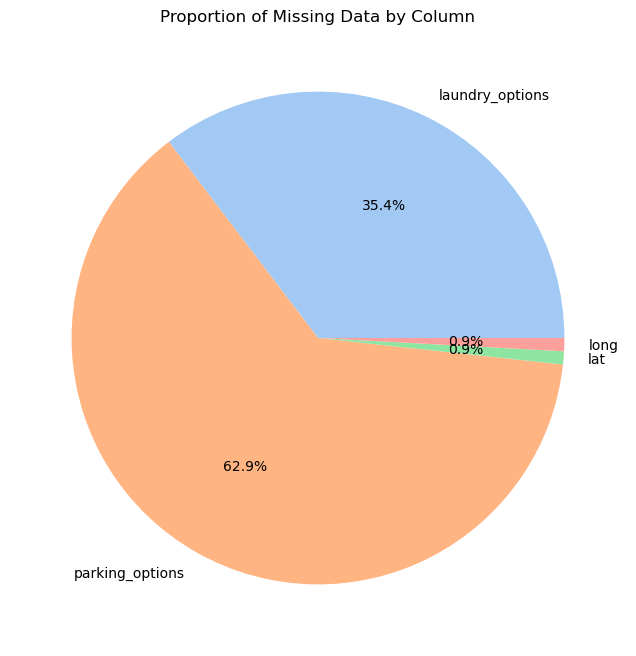

In [7]:
missing_data = dataset.isnull().sum()
missing_data_pct = missing_data / len(dataset) * 100

missing_data_pct = missing_data_pct[missing_data_pct != 0] #removing features with no missing data

plt.figure(figsize=(8,8))
plt.pie(missing_data_pct, labels=missing_data_pct.index, autopct='%1.1f%%', colors=sns.color_palette('pastel'))
plt.title('Proportion of Missing Data by Column')
plt.show()

In [8]:
# Select specific columns and create a new DataFrame
selected_columns = ['region', 'type', 'sqfeet', 'beds', 'baths', 'cats_allowed',
                    'dogs_allowed', 'smoking_allowed', 'wheelchair_access',
                    'electric_vehicle_charge', 'comes_furnished', 'laundry_options',
                    'parking_options', 'state', 'lat', 'long', 'price']
dataset1 = dataset[selected_columns].copy()

Checking for NA values in new dataset

In [9]:
dataset1.isna().sum()

region                          0
type                            0
sqfeet                          0
beds                            0
baths                           0
cats_allowed                    0
dogs_allowed                    0
smoking_allowed                 0
wheelchair_access               0
electric_vehicle_charge         0
comes_furnished                 0
laundry_options             79026
parking_options            140687
state                           0
lat                          1918
long                         1918
price                           0
dtype: int64

### 2.Remove NA values for parking and laundry by filling the NA Values with no parking and no laundry respectively 
### 3.Fill longitude and latitude with 0

In [10]:
dataset1['parking_options']=dataset1.parking_options.fillna('no parking')
dataset1['laundry_options']=dataset1.laundry_options.fillna('no laundry')
dataset1.fillna(0, inplace=True)
dataset1.isna().sum()


region                     0
type                       0
sqfeet                     0
beds                       0
baths                      0
cats_allowed               0
dogs_allowed               0
smoking_allowed            0
wheelchair_access          0
electric_vehicle_charge    0
comes_furnished            0
laundry_options            0
parking_options            0
state                      0
lat                        0
long                       0
price                      0
dtype: int64

### 4.Remove the Duplicate values from data

In [11]:
dataset1.drop_duplicates(inplace=True)


Dataset Description to see statistics:-

In [12]:
# Compute summary statistics for the DataFrame
summary_stats = dataset1.describe()

# Set the display options for pandas
pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

# Print the summary statistics
print(summary_stats)


           sqfeet       beds      baths  cats_allowed  dogs_allowed  \
count  193571.000 193571.000 193571.000    193571.000    193571.000   
mean     1174.110      1.988      1.501         0.685         0.663   
std     27004.549      4.173      0.648         0.465         0.473   
min         0.000      0.000      0.000         0.000         0.000   
25%       756.000      1.000      1.000         0.000         0.000   
50%       966.000      2.000      1.000         1.000         1.000   
75%      1200.000      3.000      2.000         1.000         1.000   
max   8388607.000   1100.000     75.000         1.000         1.000   

       smoking_allowed  wheelchair_access  electric_vehicle_charge  \
count       193571.000         193571.000               193571.000   
mean             0.675              0.083                    0.019   
std              0.468              0.275                    0.138   
min              0.000              0.000                    0.000   
25%       

### 5.Removing Outliers from Price and Square Feet Features

In [13]:
# .We can see that the data for sqfeet and price is very scaterred so we can clean it by considering value above 160 for both

In [14]:
dataset1=dataset1[dataset1["price"]>160]
dataset1=dataset1[dataset1["sqfeet"]>=160]

In [15]:
# Plot for Price

<AxesSubplot:xlabel='price', ylabel='Density'>

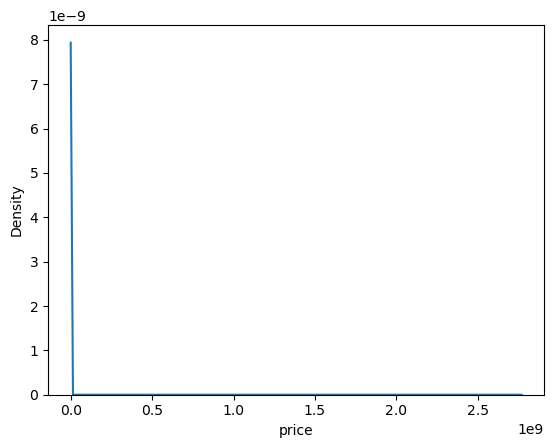

In [16]:
sns.kdeplot(x="price", data=dataset1)

In [17]:
# We can see that data is still very scaterred so we can futher clean it

<AxesSubplot:xlabel='price', ylabel='Density'>

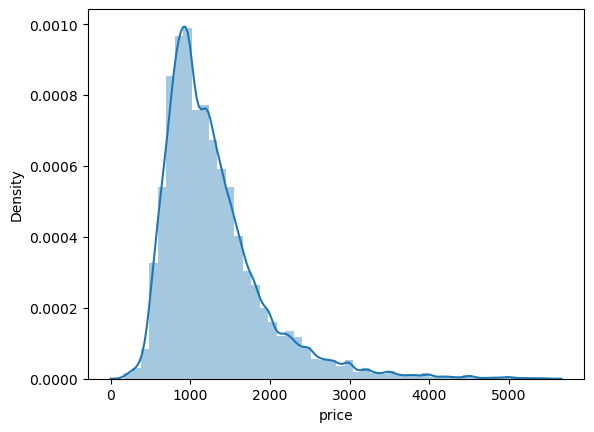

In [18]:
dataset1=dataset1[dataset1["price"]<5500]
sns.distplot(dataset1["price"])

In [19]:
# Plot for sqfeet

<AxesSubplot:xlabel='sqfeet', ylabel='Density'>

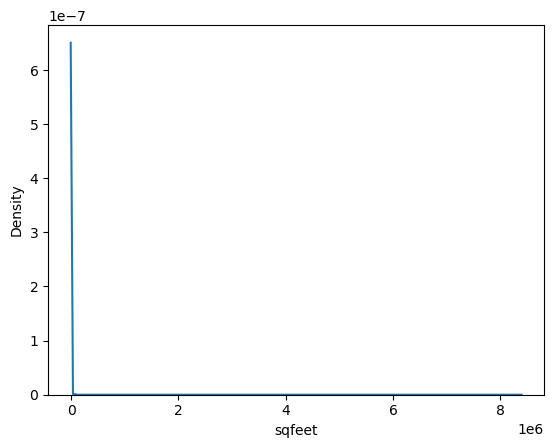

In [20]:
sns.kdeplot(x="sqfeet", data=dataset1)


In [21]:
# Further cleaning the sqfeet to get properset of values and plot it on the graph

<AxesSubplot:xlabel='sqfeet', ylabel='Density'>

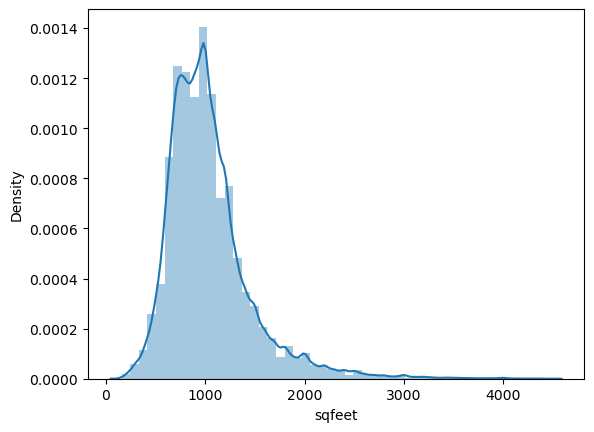

In [22]:
dataset1=dataset1[dataset1["sqfeet"]<4500]
sns.distplot(dataset1["sqfeet"])


In [23]:
# Cleaning data for number of bed and bath aswell

In [24]:
dataset1=dataset1[dataset1["beds"]<=5]
dataset1=dataset1[dataset1["baths"]<8.0]

In [25]:
# Now we have a clean dataset

In [26]:
dataset1.head()

,region,type,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,state,lat,long,price
0,reno / tahoe,apartment,1078,3,2.000,1,1,0,0,0,0,w/d in unit,carport,ca,39.548,-119.796,1148
1,reno / tahoe,condo,1001,2,2.000,0,0,0,0,0,0,w/d hookups,carport,ca,39.503,-119.789,1200
2,reno / tahoe,apartment,1683,2,2.000,1,1,1,0,0,0,w/d in unit,attached garage,ca,39.627,-119.708,1813
3,reno / tahoe,apartment,708,1,1.000,1,1,1,0,0,0,w/d in unit,carport,ca,39.448,-119.771,1095
4,reno / tahoe,apartment,250,0,1.000,1,1,1,1,0,1,laundry on site,no parking,ca,39.536,-119.805,289


# Exploratory Data Analysis

In [27]:
# Identification of Numerical Features

In [28]:
num_features = [feature for feature in dataset1.columns if dataset1[feature].dtypes != 'O']
print('Total Numerical Features: ', len(num_features))
dataset1[num_features].head()

Total Numerical Features:  12


,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,lat,long,price
0,1078,3,2.000,1,1,0,0,0,0,39.548,-119.796,1148
1,1001,2,2.000,0,0,0,0,0,0,39.503,-119.789,1200
2,1683,2,2.000,1,1,1,0,0,0,39.627,-119.708,1813
3,708,1,1.000,1,1,1,0,0,0,39.448,-119.771,1095
4,250,0,1.000,1,1,1,1,0,1,39.536,-119.805,289


In [29]:
# Visualise the distribution of numerical features using bar graph

array([[<AxesSubplot:title={'center':'sqfeet'}>,
        <AxesSubplot:title={'center':'beds'}>,
        <AxesSubplot:title={'center':'baths'}>],
       [<AxesSubplot:title={'center':'cats_allowed'}>,
        <AxesSubplot:title={'center':'dogs_allowed'}>,
        <AxesSubplot:title={'center':'smoking_allowed'}>],
       [<AxesSubplot:title={'center':'wheelchair_access'}>,
        <AxesSubplot:title={'center':'electric_vehicle_charge'}>,
        <AxesSubplot:title={'center':'comes_furnished'}>],
       [<AxesSubplot:title={'center':'lat'}>,
        <AxesSubplot:title={'center':'long'}>,
        <AxesSubplot:title={'center':'price'}>]], dtype=object)

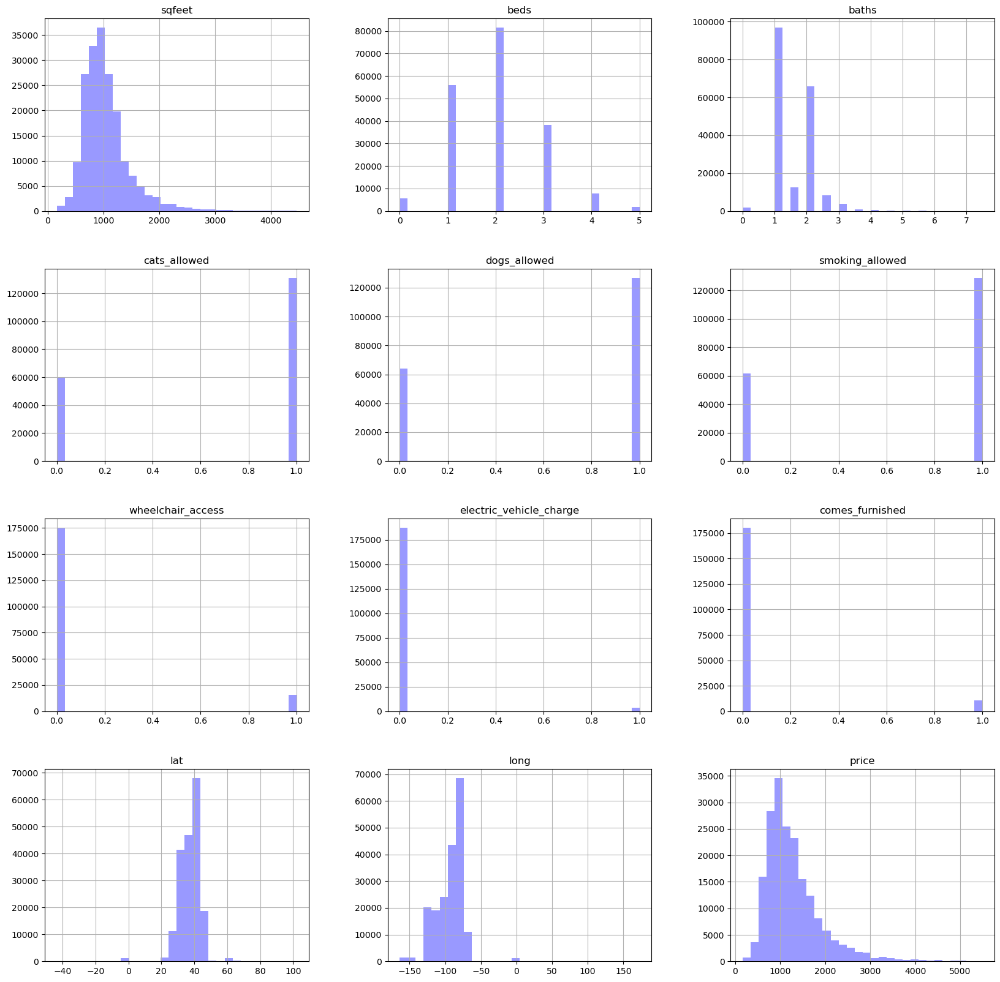

In [30]:
dataset1.hist(bins=30, figsize=(20,20), color='b', alpha=0.4)


In [31]:
# We have two type Numerical data features 
#                             1.Continuous 
#                             2.Descrete 


### Discrete Features

In [32]:
dis_features=[feature for feature in num_features if len(dataset1[feature].unique())<25 and feature ]
print("Number of Discrete Features: {}".format(len(dis_features)))

Number of Discrete Features: 8


In [33]:
#List the discrete features
dis_features

['beds',
 'baths',
 'cats_allowed',
 'dogs_allowed',
 'smoking_allowed',
 'wheelchair_access',
 'electric_vehicle_charge',
 'comes_furnished']

In [34]:
#Display Dataset only for discrete features
dataset1[dis_features].head()

,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished
0,3,2.000,1,1,0,0,0,0
1,2,2.000,0,0,0,0,0,0
2,2,2.000,1,1,1,0,0,0
3,1,1.000,1,1,1,0,0,0
4,0,1.000,1,1,1,1,0,1


In [35]:
# Plot the value of all the discrete features against price to see the features which most affect the price

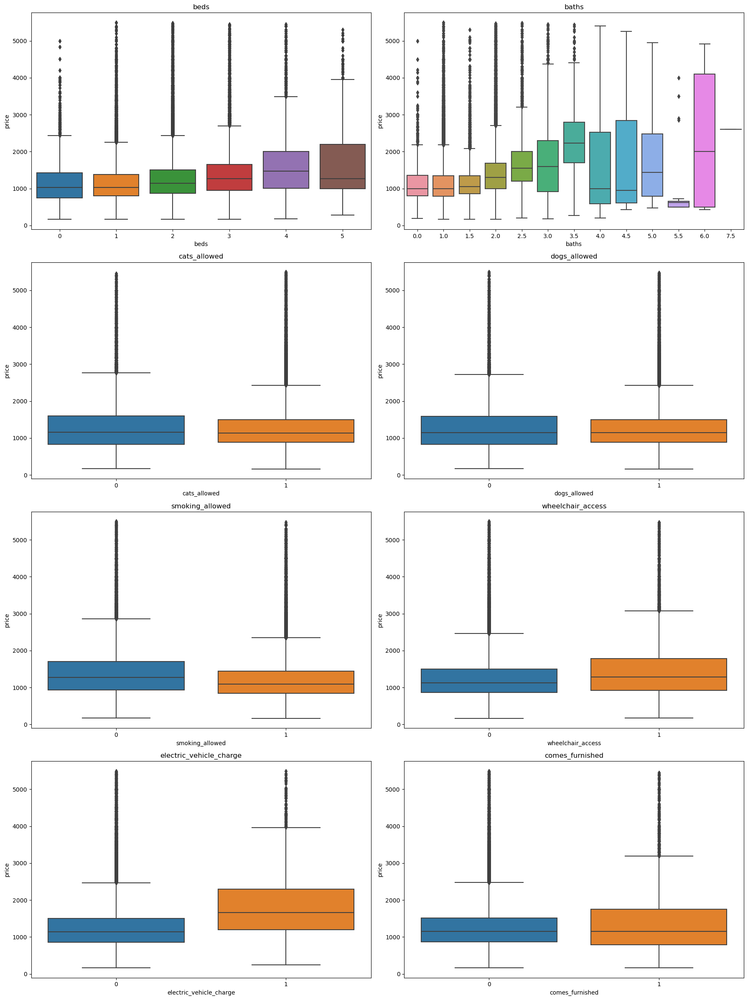

In [36]:
nrows = len(dis_features) // 2 + (len(dis_features) % 2 > 0)
fig, axs = plt.subplots(nrows=nrows, ncols=2, figsize=(18, 6*nrows))

for i, feature in enumerate(dis_features):
    row = i // 2
    col = i % 2
    sns.boxplot(x=feature, y="price", data=dataset1, ax=axs[row, col])
    axs[row, col].set_xlabel(feature)
    axs[row, col].set_ylabel('price')
    axs[row, col].set_title(feature)

plt.tight_layout()
plt.show()


### Continuous Features

In [37]:
cont_features=[feature for feature in num_features if feature not in dis_features]

print("Number of Continuous Features: {}".format(len(cont_features)))

Number of Continuous Features: 4


In [38]:
# List the columns with continuous variables

In [39]:
cont_features

['sqfeet', 'lat', 'long', 'price']

In [40]:
# Visualise the distribution of continuous features vs the price using scaterred plot

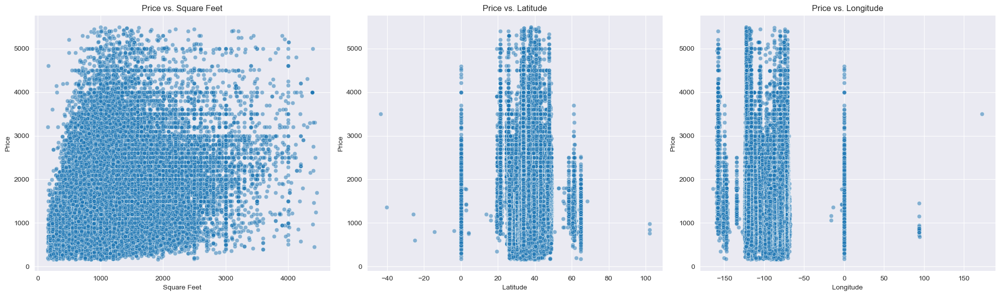

In [41]:
sns.set_style('darkgrid')

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(20, 6))

sns.scatterplot(x='sqfeet', y='price', data=dataset1, alpha=0.5, ax=axs[0])
axs[0].set_xlabel('Square Feet')
axs[0].set_ylabel('Price')
axs[0].set_title('Price vs. Square Feet')

sns.scatterplot(x='lat', y='price', data=dataset1, alpha=0.5, ax=axs[1])
axs[1].set_xlabel('Latitude')
axs[1].set_ylabel('Price')
axs[1].set_title('Price vs. Latitude')

sns.scatterplot(x='long', y='price', data=dataset1, alpha=0.5, ax=axs[2])
axs[2].set_xlabel('Longitude')
axs[2].set_ylabel('Price')
axs[2].set_title('Price vs. Longitude')

plt.tight_layout()
plt.show()


### Categorial features

In [42]:
cat_features=[feature for feature in dataset1.columns if dataset1[feature].dtypes== 'O']
cat_features


['region', 'type', 'laundry_options', 'parking_options', 'state']

In [43]:
# List and display Categorical features

In [44]:
for feature in cat_features:
    print("For {} feature  there are {} categories.".format(feature,len(dataset1[feature].unique())))

For region feature  there are 404 categories.
For type feature  there are 12 categories.
For laundry_options feature  there are 6 categories.
For parking_options feature  there are 7 categories.
For state feature  there are 51 categories.


In [45]:
# Visualise the distribution of categorical features vs the price using bar graph

In [46]:
# Display how is price affected by Laundry Options

<AxesSubplot:xlabel='laundry_options', ylabel='price'>

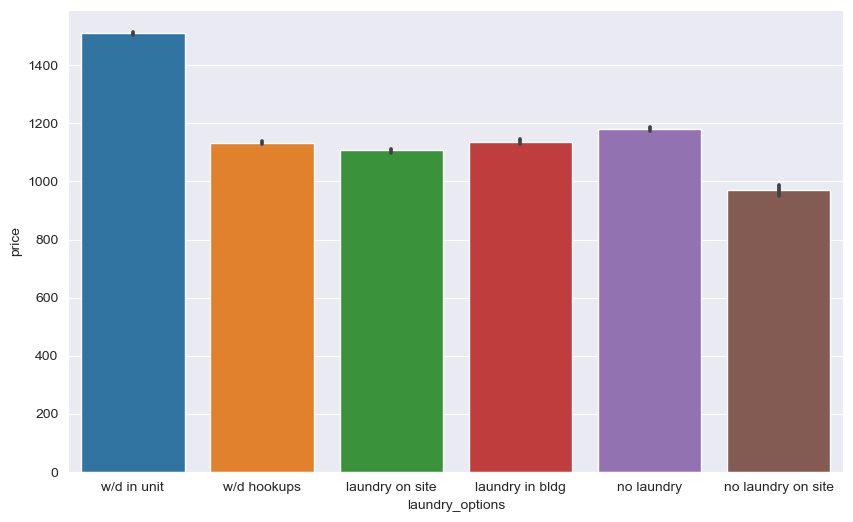

In [47]:
plt.figure(figsize=(10,6))
sns.barplot(data=dataset1, x="laundry_options", y="price")

In [48]:
# Display how is price affected by Parking Options

<AxesSubplot:xlabel='parking_options', ylabel='price'>

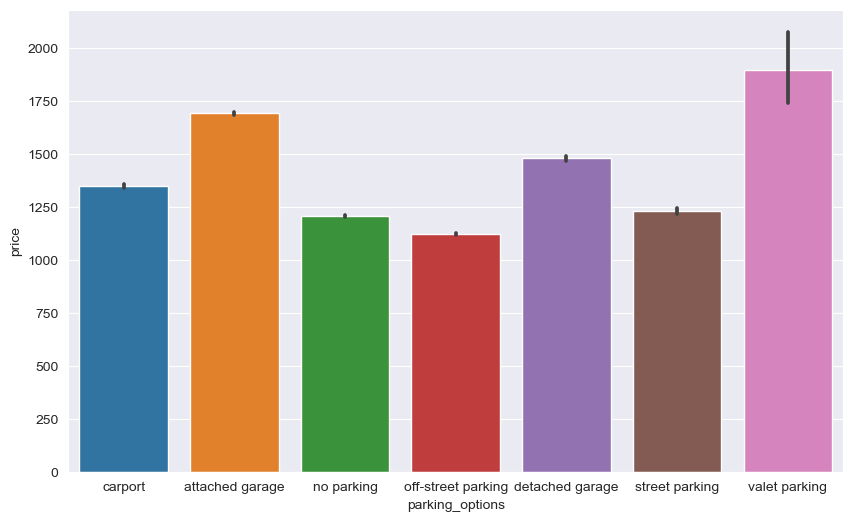

In [49]:
plt.figure(figsize=(10,6))
sns.barplot(data=dataset1, x="parking_options", y="price")


In [50]:
# Display how is price affected by Apartment Type

<AxesSubplot:xlabel='type', ylabel='price'>

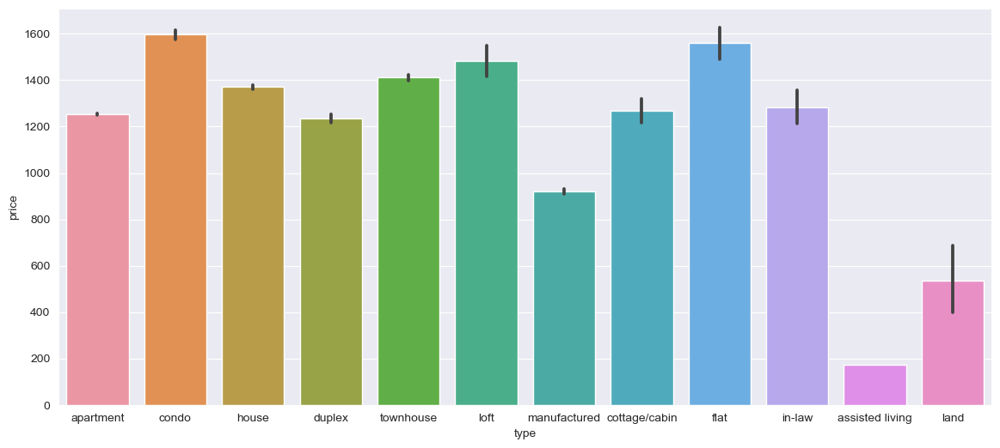

In [51]:
plt.figure(figsize=(14,6))
sns.barplot(data=dataset1, x="type", y="price")

In [52]:
# Display how is price affected by Region

<AxesSubplot:xlabel='region', ylabel='price'>

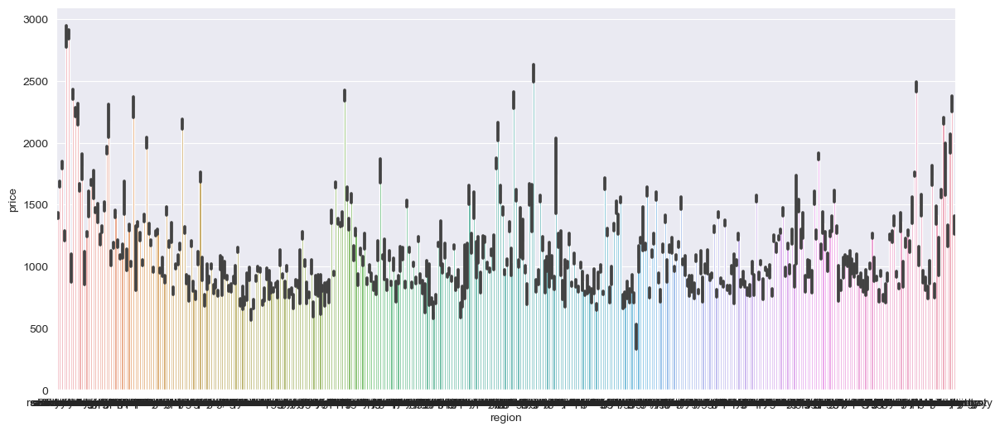

In [53]:
plt.figure(figsize=(14,6))
sns.barplot(data=dataset1, x="region", y="price")

In [54]:
# Display states that have houses with high prices

<AxesSubplot:xlabel='state', ylabel='price'>

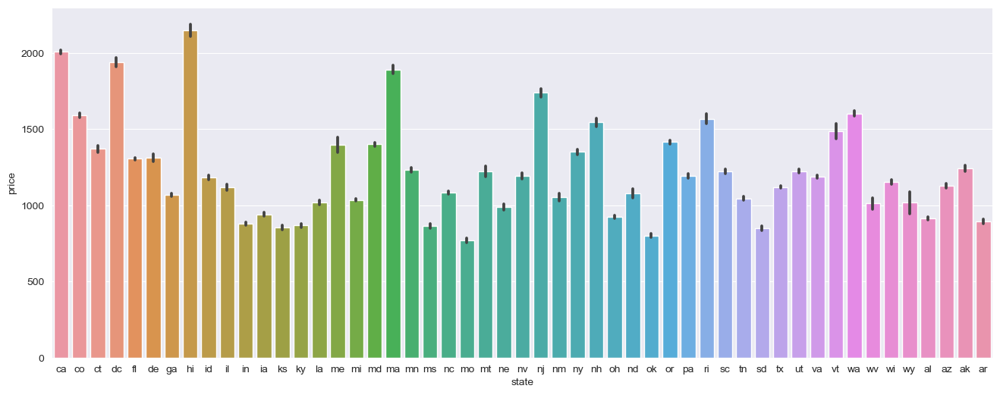

In [55]:
plt.figure(figsize=(16,6))
sns.barplot(data=dataset1, x="state", y="price")

# Machine Learning Algorithms

In [56]:
# We use preprocessor encoders to convert categorical data into numerical format so that machine learning models can work with it.

In [57]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
dataset1["state"]=le.fit_transform(dataset1["state"])
dataset1["region"]=le.fit_transform(dataset1["region"])
dataset1["laundry_options"]=le.fit_transform(dataset1["laundry_options"])
dataset1["parking_options"]=le.fit_transform(dataset1["parking_options"])
dataset1["type"]=le.fit_transform(dataset1["type"])

### Plotting Heat Map to display correlations

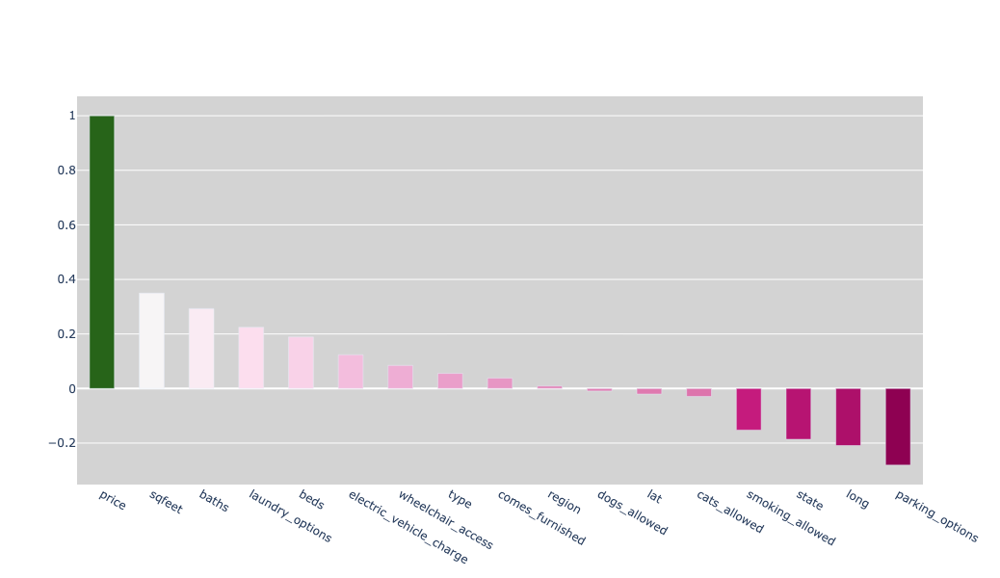

In [58]:
import plotly.graph_objs as go

corr_high = dataset1.corr()["price"].reset_index().sort_values("price", ascending=False)
fig = go.Figure(go.Bar(x=corr_high["index"], y=corr_high["price"], marker_color=corr_high["price"], width=0.5))
fig.update_layout(plot_bgcolor='lightgray', height=600)
fig.show()



In [59]:
# We can see that region and state are almost same so we can drop region column
# Also from the Data analysis we found that the parameters like the cats allowed, dogs allowd or whether the apartment is furnished 
# did not affect the price of the house so we can drop these columns.

In [60]:
dataset1.drop(["region", "cats_allowed", "dogs_allowed", "comes_furnished"], axis=1, inplace=True)


In [61]:
# Heat Map after dropping the columns

<AxesSubplot:>

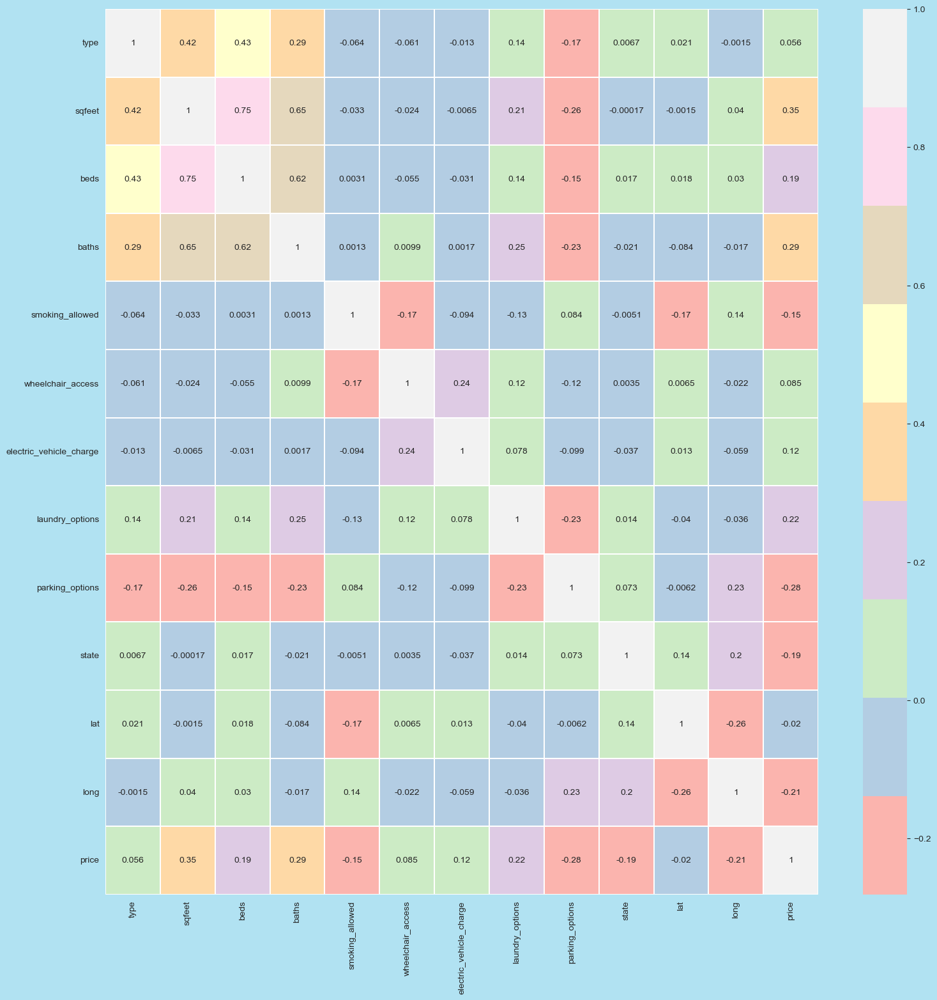

In [62]:
plt.figure(figsize=(18,18),facecolor='#b1e2f2')
sns.heatmap(dataset1.corr(), annot=True, linewidths=0.005, cmap='Pastel1')

## Training the Model 

In [63]:
# Split the data into training and test data by droppping price cololumns 
# Drop price from train model

In [64]:
y=dataset1["price"]
X=dataset1.drop("price", axis=1)

In [65]:
# Create set for train and test data 

In [66]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 0)

## Linear Regression Algorithm

In [67]:
from sklearn import metrics

linearalgo=LinearRegression()

#fit()method
linearalgo.fit(X_train, y_train)
y_pred=linearalgo.predict(X_test)

linearalgo_r2=metrics.r2_score(y_test, y_pred)
linearalgo_mse=metrics.mean_squared_error(y_test, y_pred)
linearalgo_rmse=np.sqrt(metrics.mean_squared_error(y_test, y_pred))

#Check Values
print("Value of R2:", linearalgo_r2)
print("Mean Square Error:", linearalgo_mse)
print("Root Mean Square Error: ", linearalgo_rmse)
accuracy_rate = linearalgo.score(X_test, y_test) * 100
print("Accuracy rate for Linear Reggression Model is: %.2f%%" % accuracy_rate)



Value of R2: 0.2745743989039767
Mean Square Error: 286873.0389279139
Root Mean Square Error:  535.6053014374614
Accuracy rate for Linear Reggression Model is: 27.46%


In [68]:
#Check how predicted values differ from true values

In [69]:
prediction_graph_linearalgo=pd.DataFrame({"True Values":y_test, "Predicted Values":y_pred})
prediction_graph_linearalgo

,True Values,Predicted Values
213004,2195,1351.156
347412,1189,2187.700
203412,1230,849.949
94539,1020,1275.574
339060,2300,1812.294
...,...,...
65264,1800,1082.556
51484,1150,1167.978
7290,3600,2098.586
218597,1729,1221.479


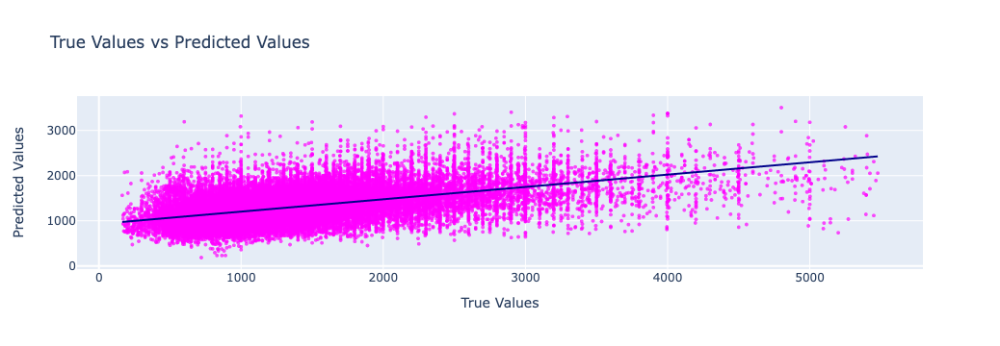

In [93]:
fig = px.scatter(prediction_graph_linearalgo, x="True Values", y="Predicted Values",
                 opacity=0.7, trendline="ols", trendline_color_override='darkblue',
                 labels={'True Values': 'True Values', 'Predicted Values': 'Predicted Values'},
                 title='True Values vs Predicted Values',
                 color_discrete_sequence=['magenta'])

fig.update_traces(marker=dict(size=4))

fig.show()

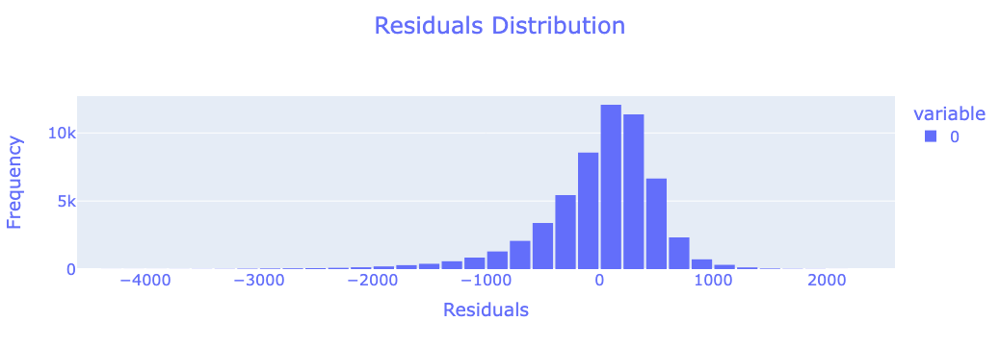

In [70]:
residuals = prediction_graph_linearalgo['Predicted Values'] - prediction_graph_linearalgo['True Values']
fig = px.histogram(residuals, nbins=50, 
                   labels={'value': 'Residuals', 'count': 'Frequency'},
                   title='Residuals Distribution',
                   color_discrete_sequence=['#636EFA'])
fig.update_layout(
    title={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.95,
        'x':0.5,
        'font': {'size': 24}
    },
    xaxis_title='Residuals',
    yaxis_title='Frequency',
    font=dict(
        size=16,
        color='#636EFA'
    ),
    bargap=0.1
)
fig.show()

In [71]:
#We can see that accuracy rate for linear regression is just 2.7%. So Lets try Decision tree model

## Decision Tree Regreesion Algorithm

In [72]:
dec_tree=DecisionTreeRegressor()

#fit()method
dec_tree.fit(X_train, y_train)
y_pred=dec_tree.predict(X_test)

dec_tree_mse= mean_squared_error(y_test, y_pred)
dec_tree_rmse= np.sqrt(mean_squared_error(y_test, y_pred))
dec_tree_r2= r2_score(y_test, y_pred)

#Check the Accuracy
print('Value of R2',r2_score(y_test, y_pred))
print('Mean Squared Error',mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error',np.sqrt(mean_squared_error(y_test, y_pred)))
print('Accuracy for Decision Tree Algorithm:', dec_tree_r2*100,'%')


Value of R2 0.6558921660988649
Mean Squared Error 136079.09602442288
Root Mean Squared Error 368.8890023088556
Accuracy for Decision Tree Algorithm: 65.58921660988649 %


In [73]:
#Check how predicted values differ from true values

In [74]:
predection_graph_dec_tree=pd.DataFrame({"True Values":y_test, "Predicted Values":y_pred})
predection_graph_dec_tree

,True Values,Predicted Values
213004,2195,2300.000
347412,1189,1189.000
203412,1230,1303.333
94539,1020,525.000
339060,2300,2200.000
...,...,...
65264,1800,2000.000
51484,1150,1171.000
7290,3600,2600.000
218597,1729,1549.000


In [75]:
# Plot for true values vs predicted values

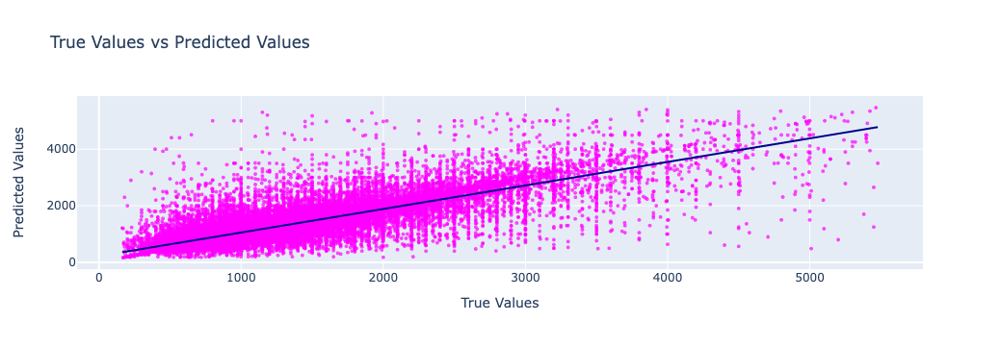

In [76]:
fig = px.scatter(predection_graph_dec_tree, x="True Values", y="Predicted Values",
                 opacity=0.7, trendline="ols", trendline_color_override='darkblue',
                 labels={'True Values': 'True Values', 'Predicted Values': 'Predicted Values'},
                 title='True Values vs Predicted Values',
                 color_discrete_sequence=['magenta'])

fig.update_traces(marker=dict(size=4))

fig.show()

In [77]:
# Accuracy score for decision tree is very low so lets do hyperparameter tuming and check the value

## Hyperparameter Tuning


In [78]:
# defining parameter's
grid_param = {
    'criterion': ['squared_error','friedman_mse'],
    'max_depth' : range(20,22),            
    'min_samples_leaf' : range(12,18),
}

# Iinitiale GridSearchCV
grid_search = GridSearchCV(estimator=dec_tree,
                     param_grid=grid_param,
                     cv=5,
                    n_jobs =-1) 

#Apply GridSearchCV
grid_search.fit(X_train,y_train)

#Result
print('Best Parameter',grid_search.best_params_)
print('Best Score',grid_search.best_score_)

Best Parameter {'criterion': 'friedman_mse', 'max_depth': 21, 'min_samples_leaf': 12}
Best Score 0.7032813922377297


## Applying Grid Search values to verify the result and check model score



In [79]:
# Iinitiale Decision Tree
dec_tree = DecisionTreeRegressor(criterion= 'squared_error', max_depth= 21, min_samples_leaf=12 )

# Apply Decision Tree model 
dec_tree.fit(X_train,y_train)

# Predict the values
y_pred = dec_tree.predict(X_test)
dec_tree_mse= mean_squared_error(y_test, y_pred)
dec_tree_rmse= np.sqrt(mean_squared_error(y_test, y_pred))
dec_tree_r2= r2_score(y_test, y_pred)

print('Mean Absolute Error',mean_absolute_error(y_test, y_pred))
print('Mean Squared Error',mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error',np.sqrt(mean_squared_error(y_test, y_pred)))
print('R2 score',r2_score(y_test, y_pred))
accuracy_rate = dec_tree.score(X_test, y_test) * 100
print("Accuracy rate for Decision Tree Reggression Model After HyperParameter Tuning is: %.2f%%" % accuracy_rate)


Mean Absolute Error 204.340761582368
Mean Squared Error 109205.07420313875
Root Mean Squared Error 330.46191036659394
R2 score 0.7238494182213673
Accuracy rate for Decision Tree Reggression Model After HyperParameter Tuning is: 72.38%


In [90]:
prediction_graph_dec_tree=pd.DataFrame({"True Values":y_test, "Predicted Values":y_pred})
prediction_graph_dec_tree



,True Values,Predicted Values
213004,2195,2371.059
347412,1189,1228.625
203412,1230,1288.348
94539,1020,822.443
339060,2300,1620.727
...,...,...
65264,1800,1624.305
51484,1150,1099.348
7290,3600,2894.999
218597,1729,1529.006


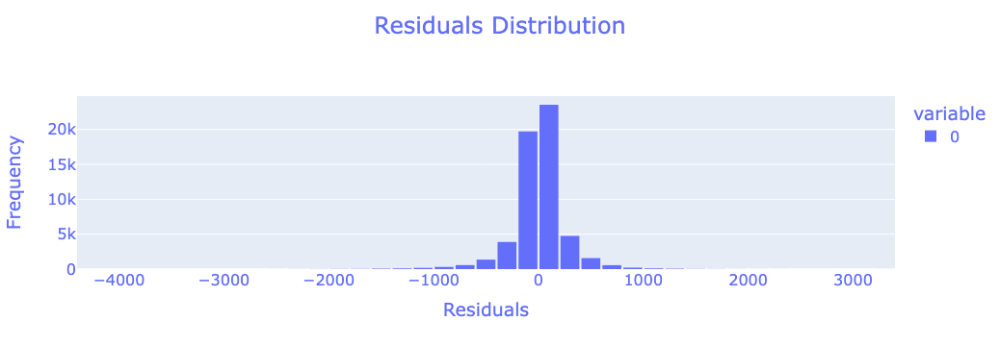

In [92]:
residuals = prediction_graph_dec_tree['Predicted Values'] - prediction_graph_dec_tree['True Values']

fig = px.histogram(residuals, nbins=50, 
                   labels={'value': 'Residuals', 'count': 'Frequency'},
                   title='Residuals Distribution',
                   color_discrete_sequence=['#636EFA'])

fig.update_layout(
    title={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.95,
        'x':0.5,
        'font': {'size': 24}
    },
    xaxis_title='Residuals',
    yaxis_title='Frequency',
    font=dict(
        size=16,
        color='#636EFA'
    ),
    bargap=0.1
)

fig.show()

## Random Forest Regression Algorithm

In [80]:
from sklearn.ensemble import RandomForestRegressor


ran_forest = RandomForestRegressor(n_estimators=100, max_depth=21, n_jobs=-1, random_state=42)

# Fitting method
ran_forest.fit(X_train, y_train)

#Prediction using the Random Forest model
y_pred = ran_forest.predict(X_test)

ran_forest_mse= mean_squared_error(y_test, y_pred)
ran_forest_rmse= np.sqrt(mean_squared_error(y_test, y_pred))
ran_forest_r2= r2_score(y_test, y_pred)

# Lets Evaluate the performance of the Random Forest Regression Model:-
print('Value for R2:', ran_forest_r2)
print('Mean Absolute Error:', mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(mean_squared_error(y_test, y_pred)))
print('Accuracy for :', ran_forest_r2*100,'%')


Value for R2: 0.8088739350471906
Mean Absolute Error: 161.1178692432909
Mean Squared Error: 75581.72056308316
Root Mean Squared Error: 274.9212988531139
Accuracy for : 80.88739350471906 %


In [81]:
# Check Predicted values against True Values

In [82]:
prediction_graph_ran_forest=pd.DataFrame({"True Values":y_test, "Predicted Values":y_pred})
prediction_graph_ran_forest



,True Values,Predicted Values
213004,2195,2371.059
347412,1189,1228.625
203412,1230,1288.348
94539,1020,822.443
339060,2300,1620.727
...,...,...
65264,1800,1624.305
51484,1150,1099.348
7290,3600,2894.999
218597,1729,1529.006


In [83]:
#Plot the scaterred plot for Predicted Values Against True Vales

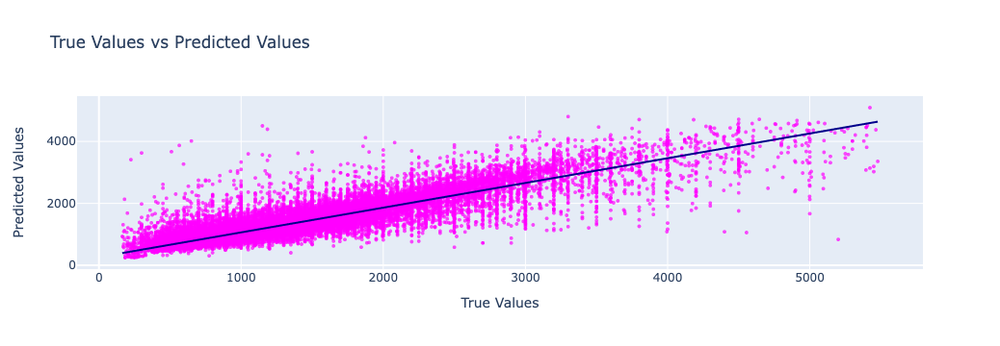

In [84]:
fig = px.scatter(prediction_graph_ran_forest, x="True Values", y="Predicted Values",
                 opacity=0.7, trendline="ols", trendline_color_override='darkblue',
                 labels={'True Values': 'True Values', 'Predicted Values': 'Predicted Values'},
                 title='True Values vs Predicted Values',
                 color_discrete_sequence=['magenta'])

fig.update_traces(marker=dict(size=4))
fig.show()

In [85]:
# Plot for Residual Values

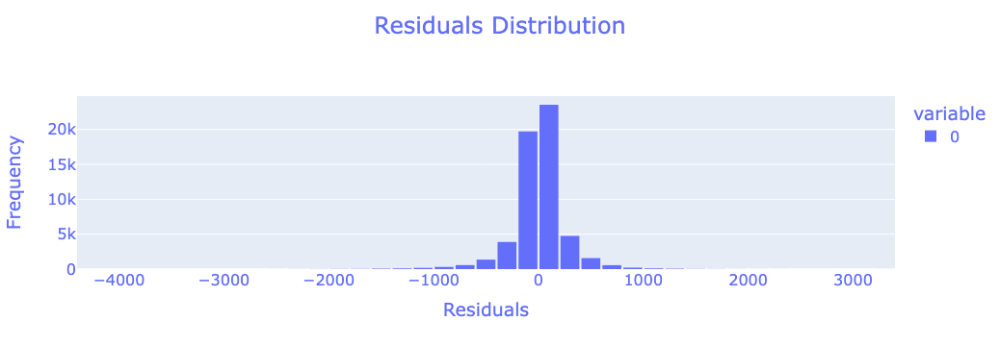

In [86]:

residuals = prediction_graph_ran_forest['Predicted Values'] - prediction_graph_ran_forest['True Values']

fig = px.histogram(residuals, nbins=50, 
                   labels={'value': 'Residuals', 'count': 'Frequency'},
                   title='Residuals Distribution',
                   color_discrete_sequence=['#636EFA'])

fig.update_layout(
    title={
        'xanchor': 'center',
        'yanchor': 'top',
        'y':0.95,
        'x':0.5,
        'font': {'size': 24}
    },
    xaxis_title='Residuals',
    yaxis_title='Frequency',
    font=dict(
        size=16,
        color='#636EFA'
    ),
    bargap=0.1
)

fig.show()


## Comparision Between Linear Regression, Decision Tree Regression and Random Forest Regression Algorithms

In [87]:
model={"Linear Regression":[linearalgo_r2,linearalgo_mse,linearalgo_rmse],
       "Decision Tree":[dec_tree_r2,dec_tree_mse,dec_tree_rmse],
       "Random Forest":[ran_forest_r2,ran_forest_mse,ran_forest_rmse]} # add closing square bracket here
model=pd.DataFrame(model)
model=model.rename(index={0:"R2", 1:"MSE", 2:"RMSE"})

In [88]:
model

,Linear Regression,Decision Tree,Random Forest
R2,0.275,0.724,0.809
MSE,286873.039,109205.074,75581.721
RMSE,535.605,330.462,274.921


#### Conclusion:- We can see that Random Forest Regression is the Best Fit for House Price Prediction According to our Model.